# YOLOv5 - Gun detection

**References**
- Tutorial: YOLO v5 Custom Training

  https://www.youtube.com/watch?v=T0DO1C8uYP8&t=166s&ab_channel=%EB%B9%B5%ED%98%95%EC%9D%98%EA%B0%9C%EB%B0%9C%EB%8F%84%EC%83%81%EA%B5%AD

- Dataset from: roboflow
  https://public.roboflow.com/object-detection/pistols


## Get Model

https://github.com/ultralytics/yolov5.git

In [1]:
%cd /content
!git clone https://github.com/ultralytics/yolov5.git

/content
Cloning into 'yolov5'...
remote: Enumerating objects: 9923, done.
remote: Total 9923 (delta 0), reused 0 (delta 0), pack-reused 9923
Receiving objects: 100% (9923/9923), 10.24 MiB | 22.41 MiB/s, done.
Resolving deltas: 100% (6875/6875), done.


In [2]:
%cd /content/yolov5
!pip install -r requirements.txt

/content/yolov5
     |████████████████████████████████| 596 kB 13.9 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


## Get Data

In [3]:
# download data
!curl -L "https://public.roboflow.com/ds/kX4gQcl0b7?key=5seaFEcM9V" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

 extracting: export/labels/armas (1614)_jpg.rf.ffcca44ff2fae51730498a8cfb30a0ac.txt  
 extracting: data.yaml               
 extracting: README.roboflow.txt     
 extracting: README.dataset.txt      


### label

`class, x, y, width, height`

    0 0.27291666666666664 0.34827586206896555 0.5208333333333334 0.6827586206896552
    0 0.7520833333333333 0.6586206896551724 0.4791666666666667 0.6689655172413793

### file setup

In [7]:
%cat /content/dataset/data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['pistol']

In [8]:
%cd / 
from glob import glob

img_list = glob("/content/dataset/export/images/*.jpg")
print(len(img_list))

/
2971


In [9]:
from sklearn.model_selection import train_test_split

train_img_list, val_img_list = train_test_split(img_list, test_size=0.2, random_state=42)
print(len(train_img_list), len(val_img_list))

2376 595


In [10]:
with open("/content/dataset/train.txt", "w") as f:
    f.write('\n'.join(train_img_list) + '\n')

with open("/content/dataset/val.txt", "w") as f:
    f.write('\n'.join(val_img_list) + '\n')

In [11]:
import yaml

with open("/content/dataset/data.yaml", "r") as f:
    data = yaml.safe_load(f)

print(data)
data["train"] = '/content/dataset/train.txt'
data["val"] = "/content/dataset/val.txt"

with open('/content/dataset/data.yaml', 'w') as f:
    yaml.dump(data, f)

print(data)

{'train': '../train/images', 'val': '../valid/images', 'nc': 1, 'names': ['pistol']}
{'train': '/content/dataset/train.txt', 'val': '/content/dataset/val.txt', 'nc': 1, 'names': ['pistol']}


In [12]:
%cd /content/yolov5/

!python train.py --img 416 --batch 16 --epochs 100 --data /content/dataset/data.yaml --cfg ./models/yolov5s.yaml --weights yolov5s.pt --name gun_yolov5s_results

/content/yolov5
train: weights=yolov5s.pt, cfg=./models/yolov5s.yaml, data=/content/dataset/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=gun_yolov5s_results, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-55-g0155548 torch 1.9.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015

## Tensorboard

In [14]:
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Predict using test dataset

In [19]:
from IPython.display import Image
import os

val_img_path = val_img_list[0]

!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 416 --conf 0.5 --source "{val_img_path}"

detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/dataset/export/images/armas (1075)_jpg.rf.16016f098c42f2470b6615d43c262f54.jpg, imgsz=[416, 416], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-55-g0155548 torch 1.9.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/dataset/export/images/armas (1075)_jpg.rf.16016f098c42f2470b6615d43c262f54.jpg: 416x416 1 pistol, Done. (0.029s)
Speed: 0.4ms pre-process, 28.5ms inference, 2.5ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp


In [20]:
for i in range(10): 
    val_img_path = val_img_list[i]
    !python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 416 --conf 0.5 --source "{val_img_path}"

detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/dataset/export/images/armas (1075)_jpg.rf.16016f098c42f2470b6615d43c262f54.jpg, imgsz=[416, 416], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-55-g0155548 torch 1.9.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/dataset/export/images/armas (1075)_jpg.rf.16016f098c42f2470b6615d43c262f54.jpg: 416x416 1 pistol, Done. (0.029s)
Speed: 0.4ms pre-process, 28.7ms inference, 2.6ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp2
detect: weights=['/content/yolov5/runs/train

## VISUALISE Results

### Training Overview

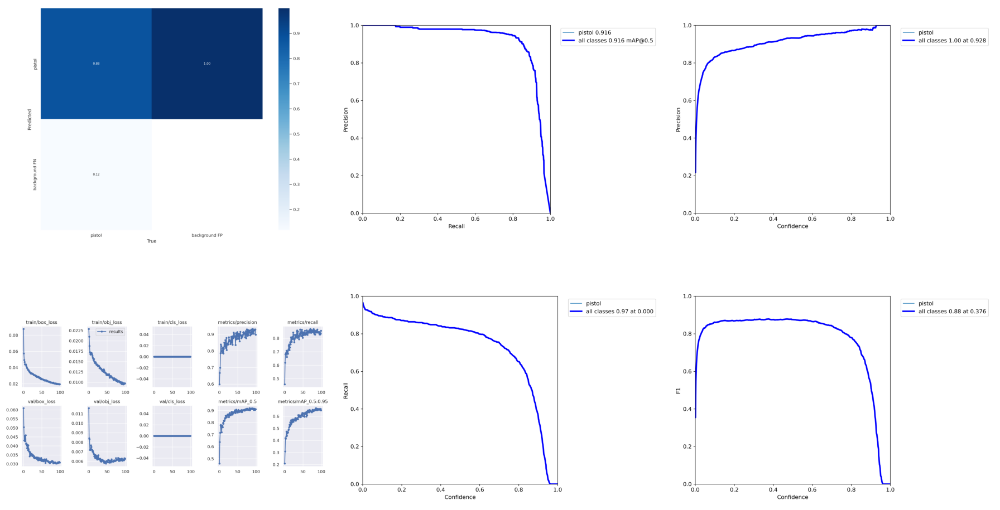

In [89]:
TRAIN_RESULTS_DIR = "/content/yolov5/runs/train/gun_yolov5s_results/"
results = os.listdir(TRAIN_RESULTS_DIR)
results = [result for result in results if result.endswith(".png")]

fig, axes = plt.subplots(2, 3, figsize=(25, 15))

idx = 0
for i in range(2):
    for j in range(3):
        img = imread(TRAIN_RESULTS_DIR + results[idx])
        axes[i][j].imshow(img)
        axes[i][j].axis("off")
        idx += 1

plt.tight_layout()
plt.show()

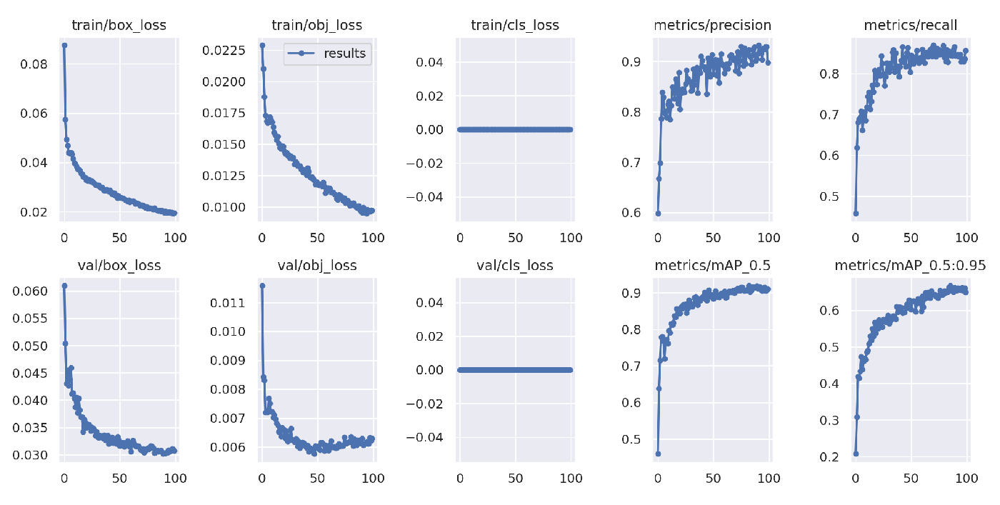

In [95]:
plt.figure(figsize=(20, 15))
img = imread(TRAIN_RESULTS_DIR + results[3])
imshow(img)
plt.axis('off')
plt.show()

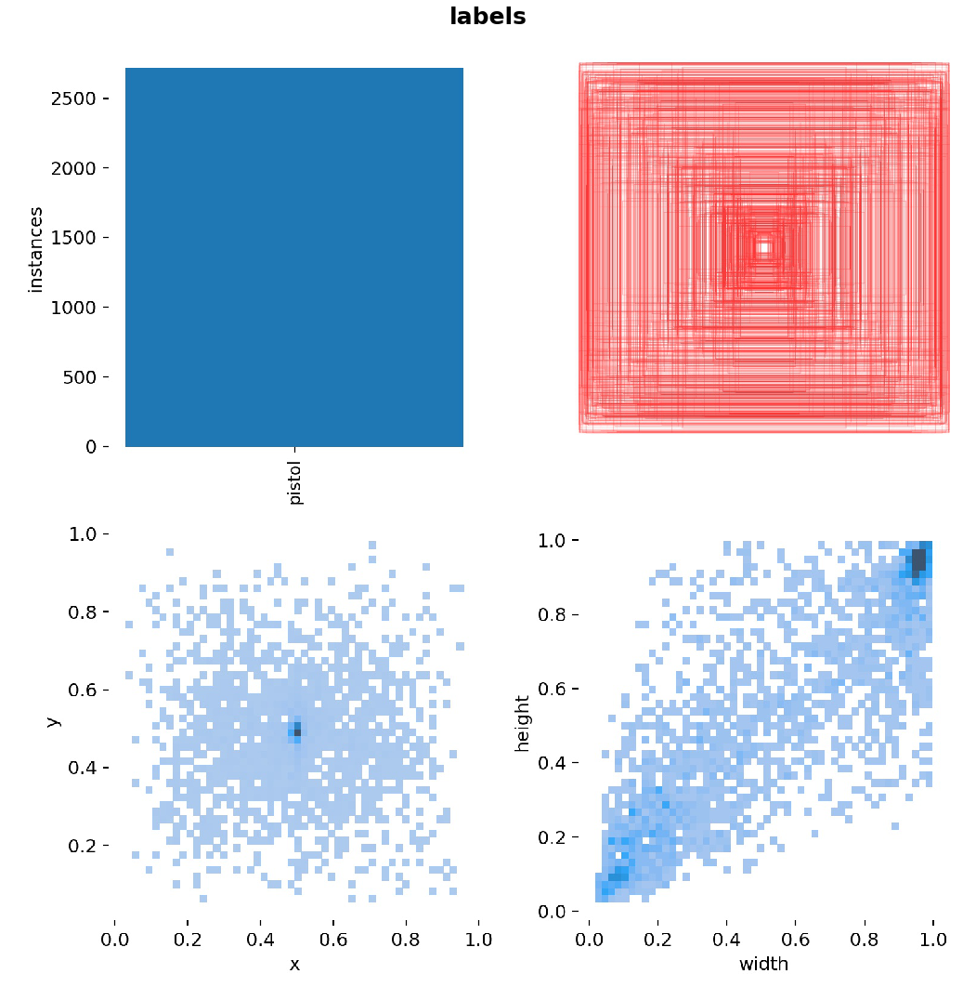

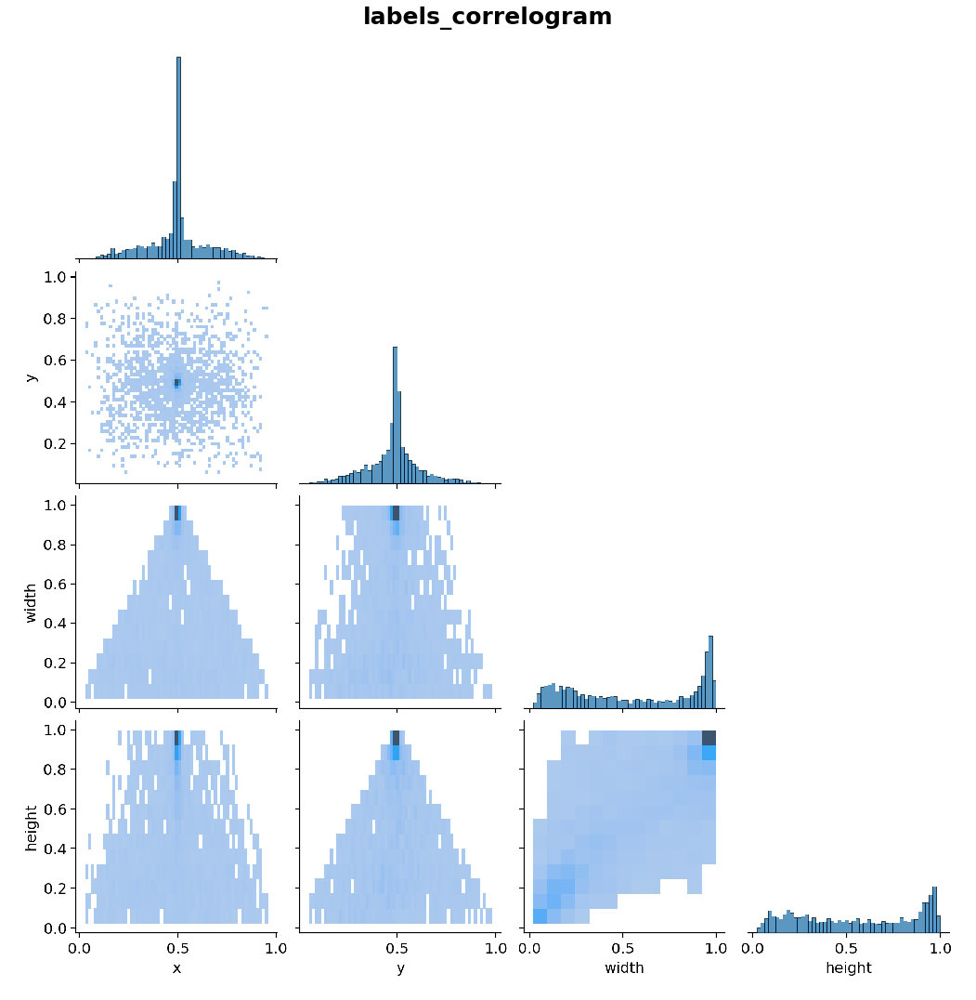

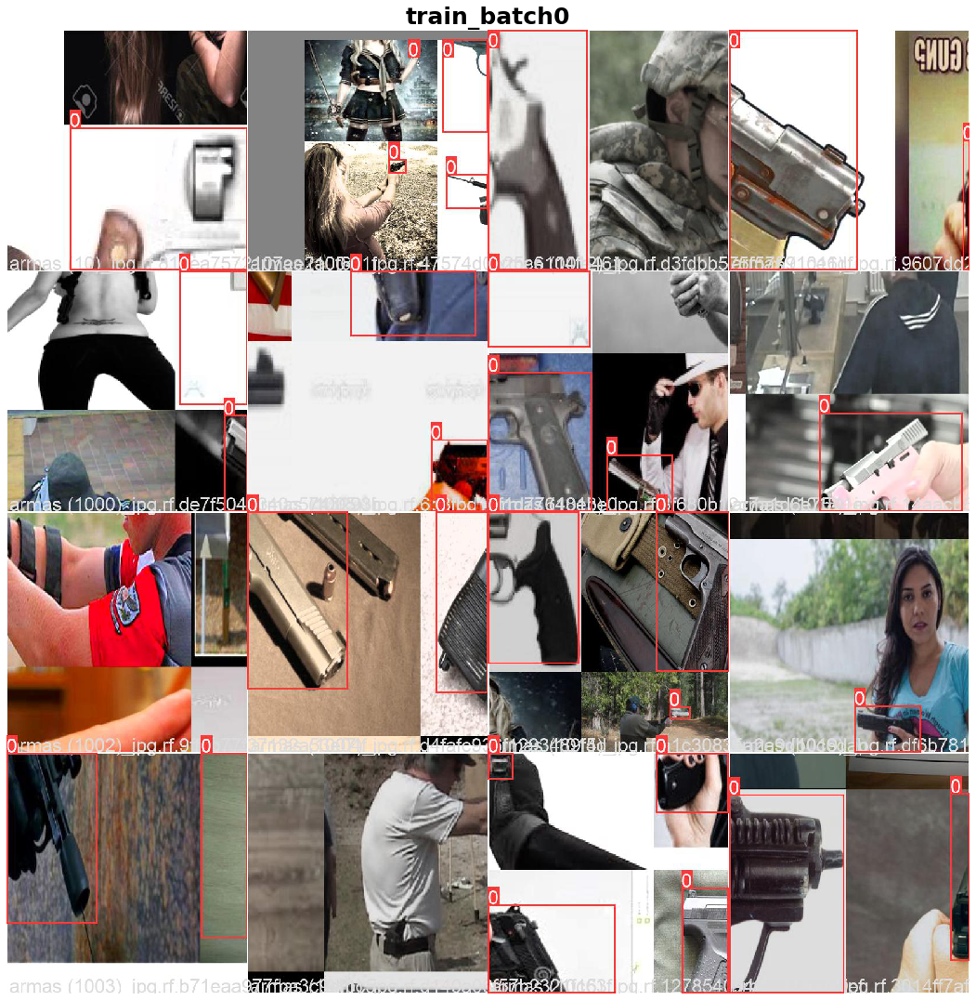

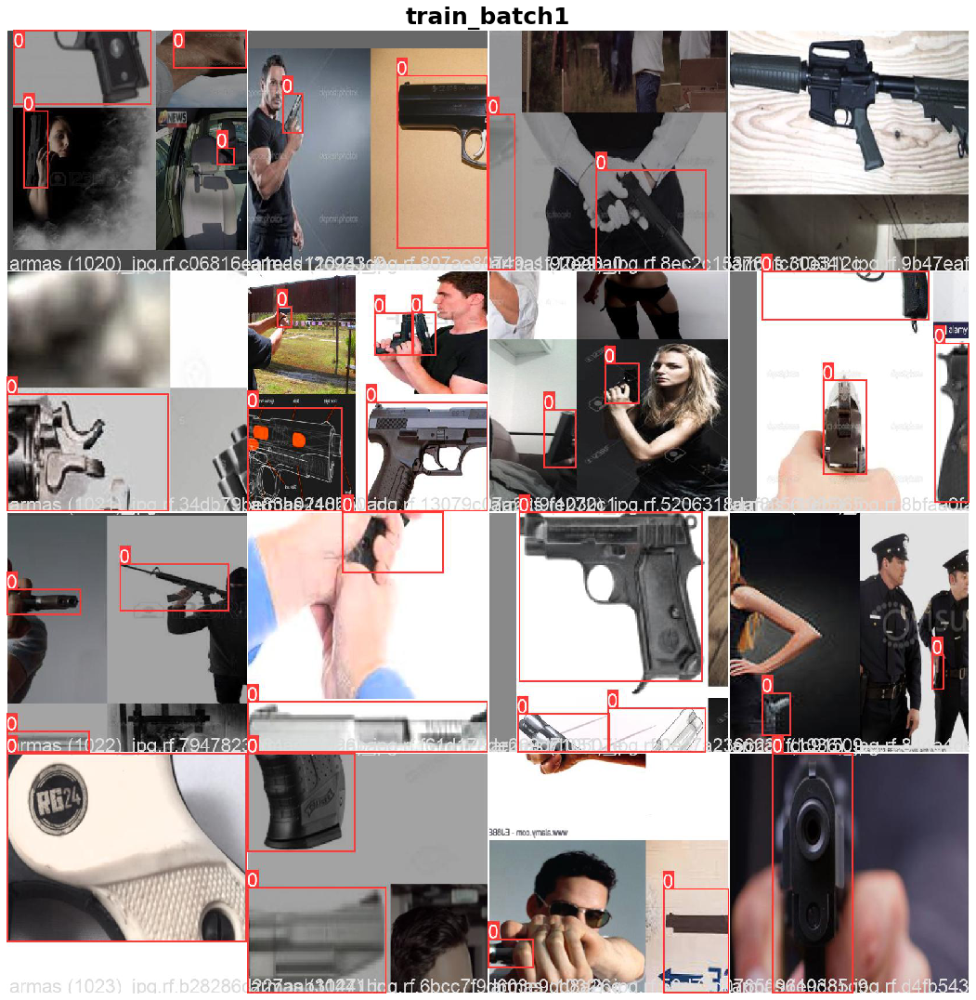

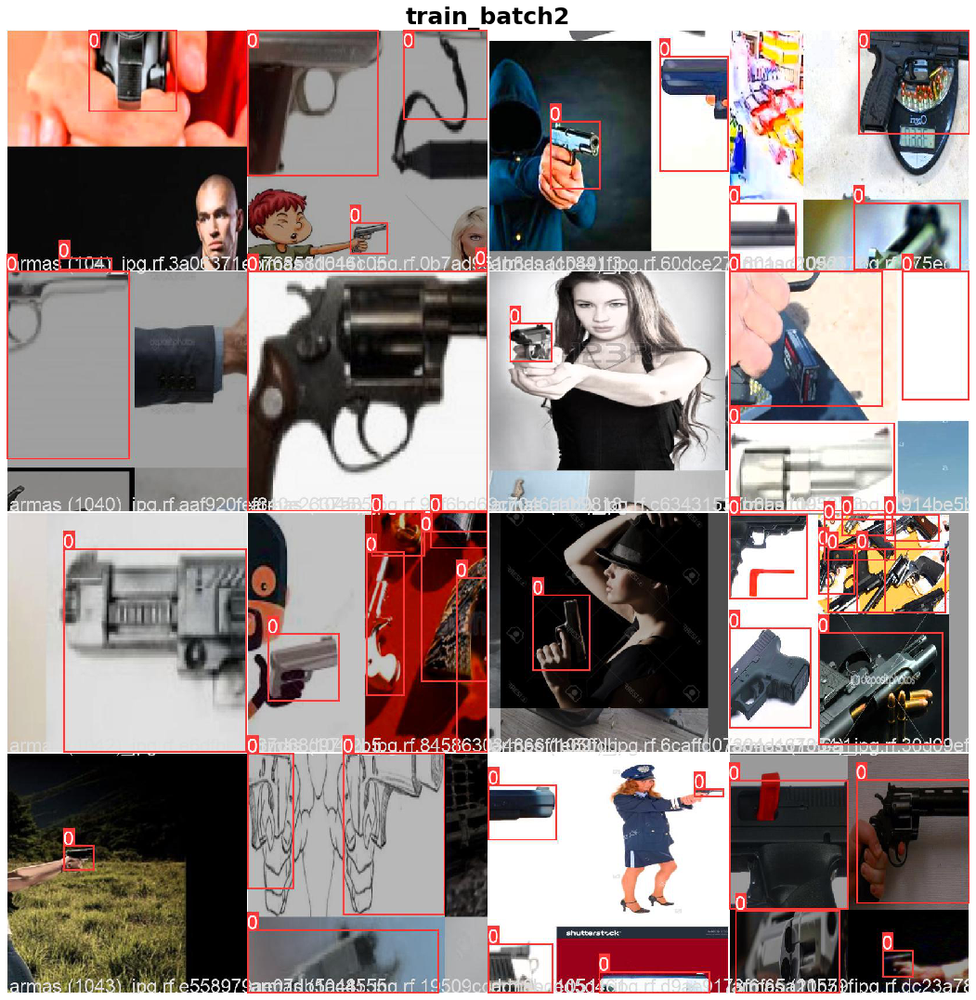

...

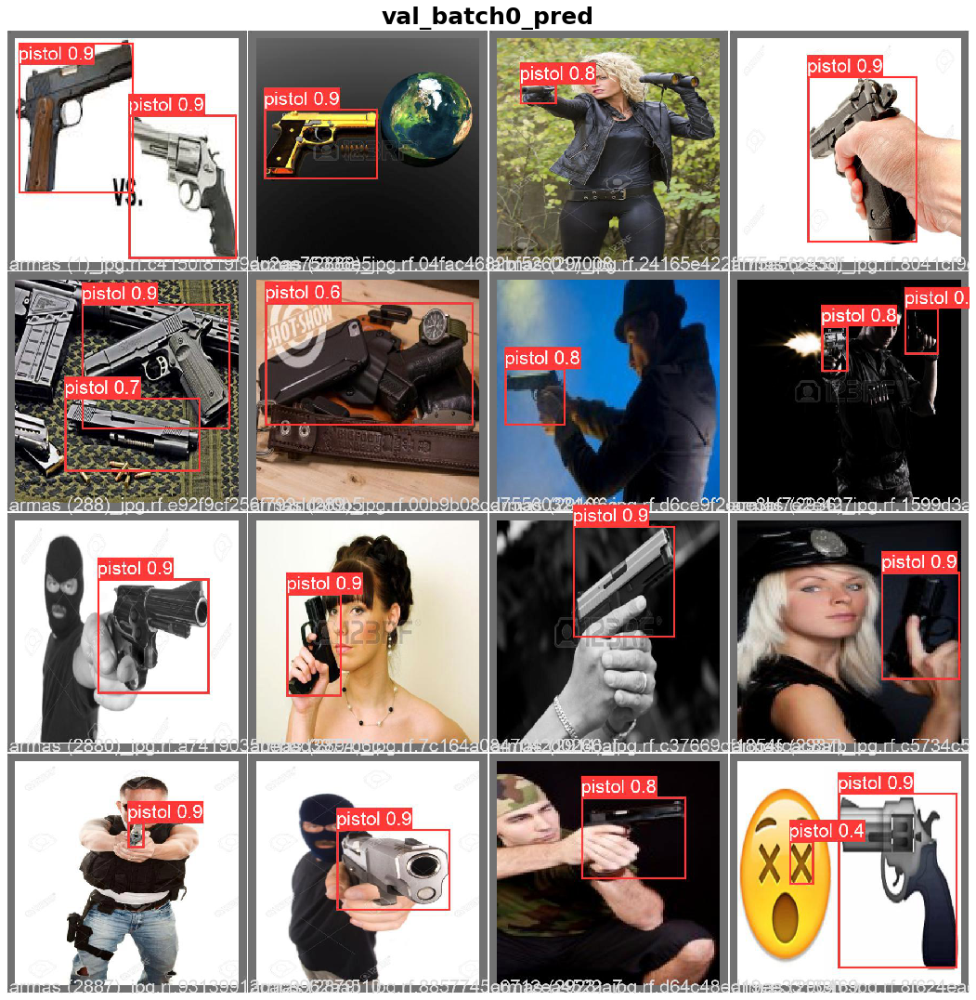

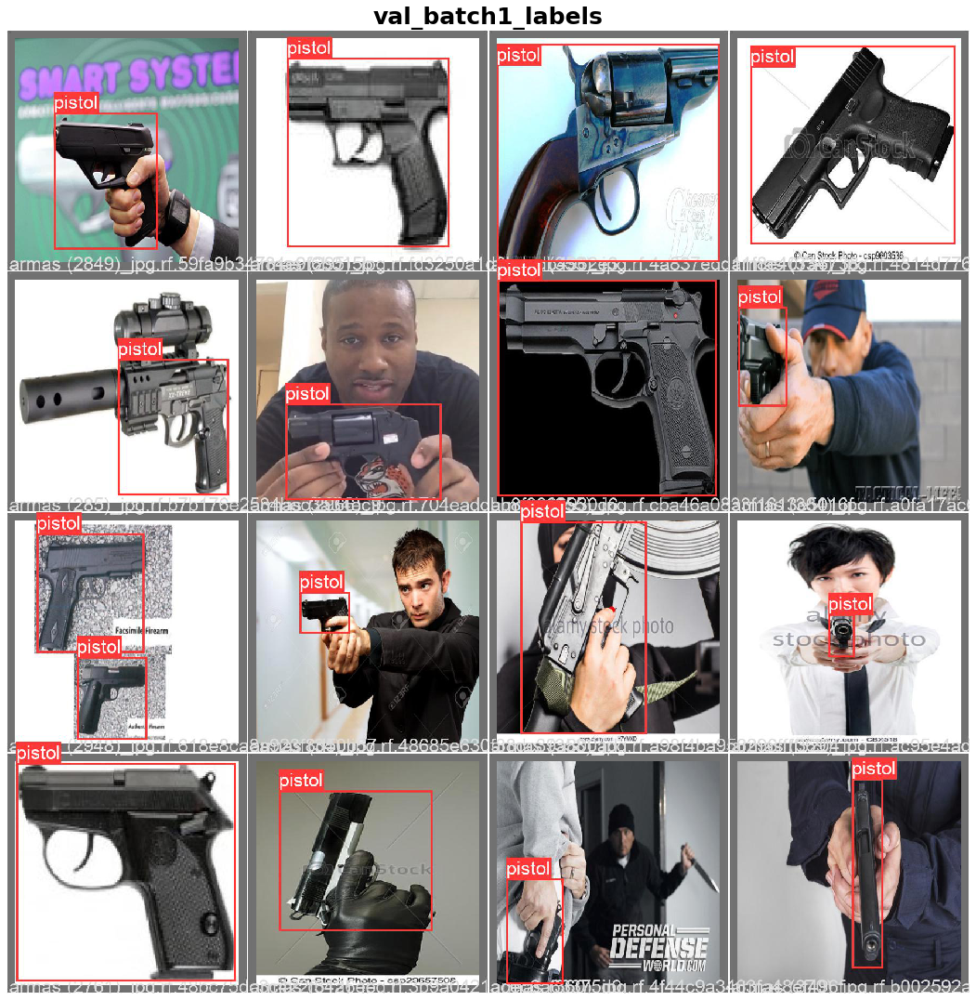

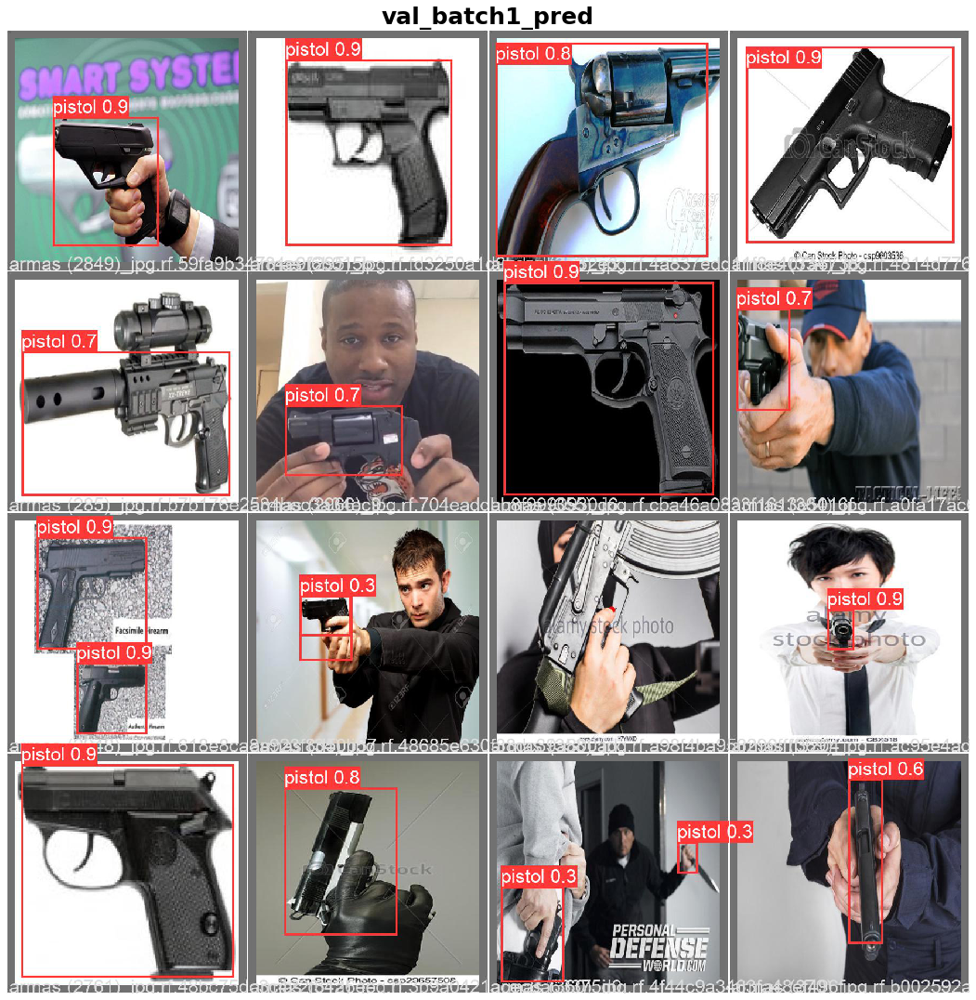

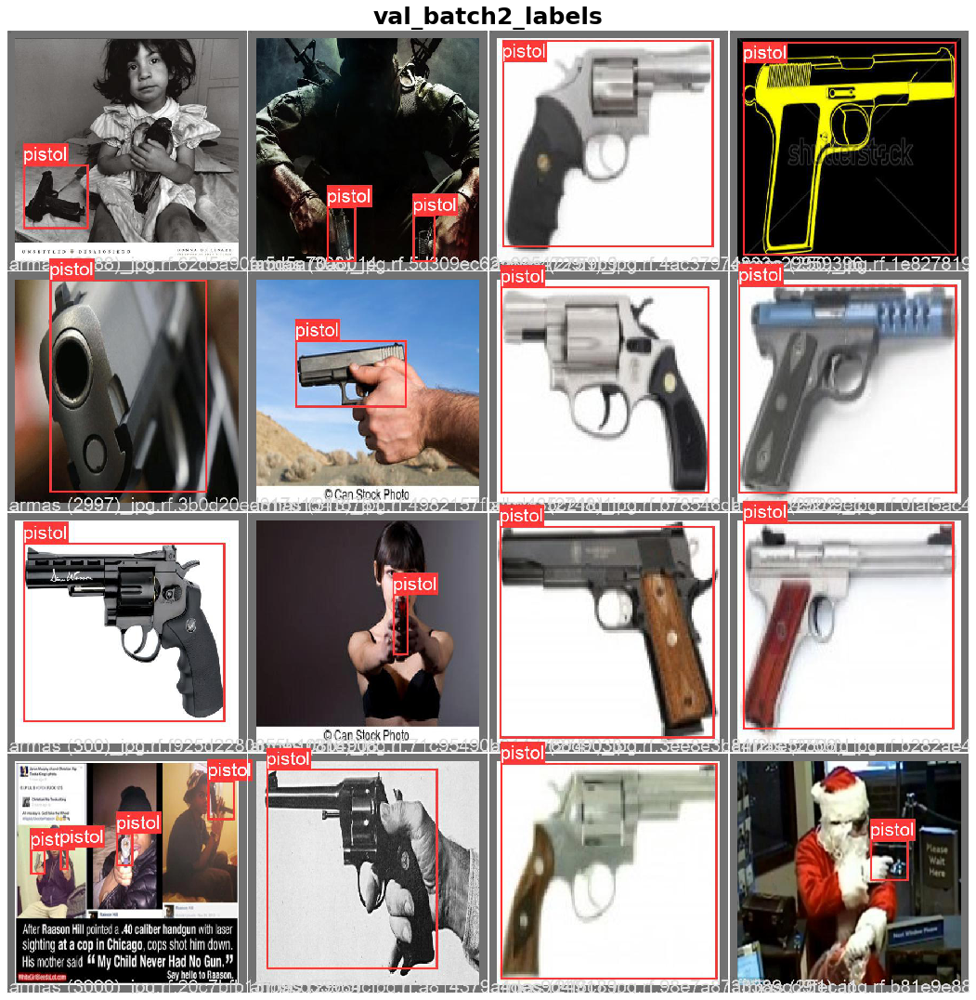

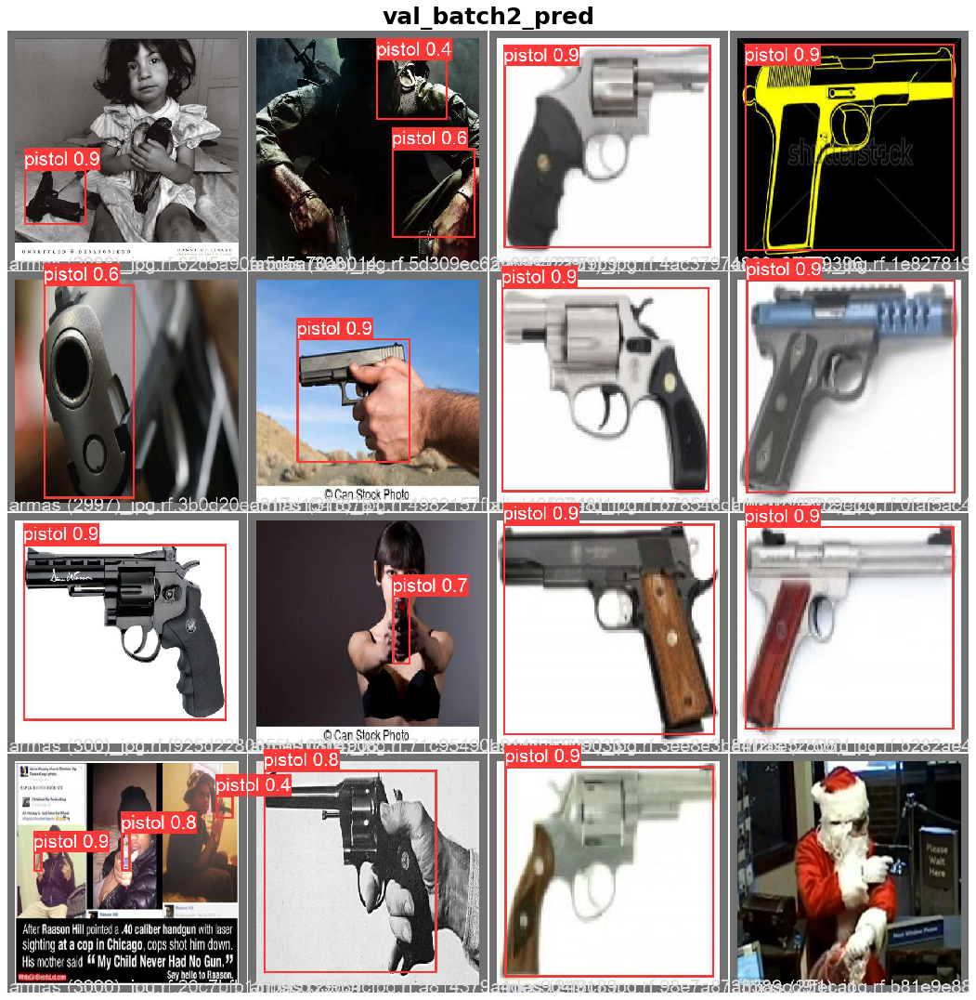

In [103]:
import re
TRAIN_RESULTS_DIR = "/content/yolov5/runs/train/gun_yolov5s_results/"
results = os.listdir(TRAIN_RESULTS_DIR)
results = [result for result in results if result.endswith(".jpg")]
results.sort()

for result in results:
    plt.figure(figsize=(15, 15))
    img = imread(TRAIN_RESULTS_DIR + result)
    imshow(img)
    plt.axis("off")
    title = re.sub(".jpg", "", result)
    title.capitalize()
    plt.title(title, fontsize=25, fontweight="bold")
    plt.show()
    print("")

### Predictions in image
The prediction results using the trained model!
- 90% accuracy with over 90% confidence for every correct prediction

#### Method 1

In [76]:
from IPython.display import Image

val_img_path = val_img_list[2]

print(val_img_path)
!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 416 --conf 0.5 --source "{val_img_path}"
Image(os.path.join('/content/yolov5/inference/output', os.path.basename(val_img_path)))

/content/dataset/export/images/armas (935)_jpg.rf.8713bb09e43b86daebd9ff4b26eeacab.jpg
detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/dataset/export/images/armas (935)_jpg.rf.8713bb09e43b86daebd9ff4b26eeacab.jpg, imgsz=[416, 416], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-55-g0155548 torch 1.9.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/dataset/export/images/armas (935)_jpg.rf.8713bb09e43b86daebd9ff4b26eeacab.jpg: 416x416 1 pistol, Done. (0.029s)
Speed: 0.4ms pre-process, 28.7ms inference, 1.9ms NMS per image at shape (1, 3, 416

#### Method 2

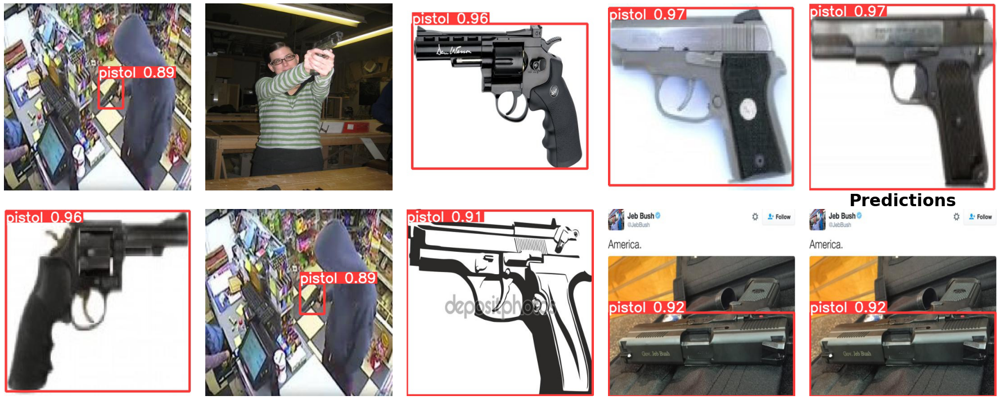

In [106]:
from skimage.io import imread, imshow
import matplotlib.pyplot as plt

ROOT_DIR = "/content/yolov5/runs/detect/"
exps = next(os.walk(ROOT_DIR))[1]

fig, axes = plt.subplots(2, 5, figsize=(25, 10))

idx = 0
for i in range(2):
    for j in range(5):
        path = ROOT_DIR + exps[idx] + "/"
        img = imread(path + os.listdir(path)[0])    # imread(path)
        axes[i][j].imshow(img)                      # imshow(array)
        axes[i][j].axis("off")
        idx += 1

plt.tight_layout()
plt.show()

### Performance parameters

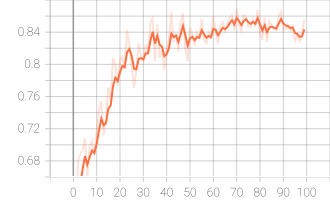

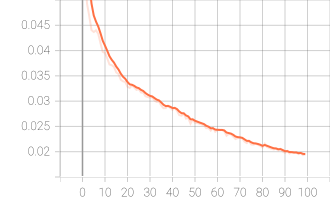

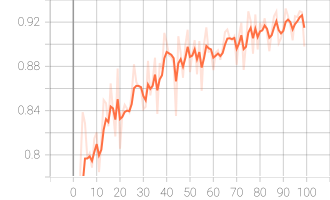

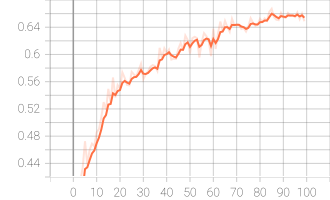

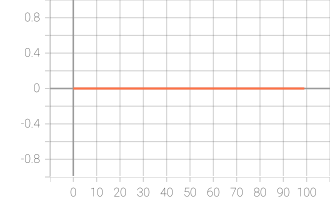

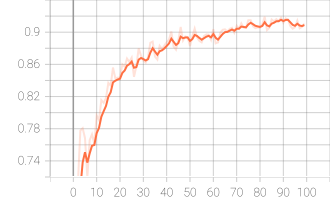

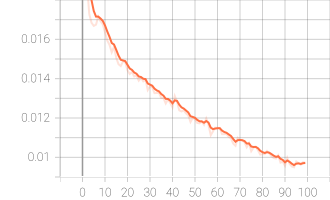

In [72]:
from IPython.display import SVG, display

GRAPH_DIR = "/content/graphs/"
graphs = os.listdir(GRAPH_DIR)

def show_svg(path):
    display(SVG(path))

for graph in graphs:
    show_svg(GRAPH_DIR + graph)